# Predicting voters turnout for US election in 2016 using AutoML - Part I

## Table of Contents <a class="anchor" id="0"></a>
* [Introduction](#1) 
* [Imports](#2)
* [Connecting to ArcGIS](#3)
* [Accessing & Visualizing the datasets](#4)
* [Model Building](#9)
    * [Train-Test Data split](#70)
    * [Data Preparation](#11)
* [Fitting a Random Forest model](#5)
* [Fitting using AutoML](#6)
     * [Model output](#5f) 
* [Voters turnout prediction & Validation](#8a)
     * [Estimate model metrics for validation](#8c)
* [Conclusion](#10)
* [Data resources](#25)    

## Introduction <a class="anchor" id="1"></a>

The objective of this notebook is to demonstrate the application of AutoML on tabular data and show the improvements that can be achieved using this method, rather than conventional workflows. The newly added AutoML module in arcgis.learn is based on the MLJar library, which automates the processes of algorithm selection, data preprocessing, model training, model explainability, and final model evaluation. With these functionalities, it can perform Automatic Exploratory Data Analysis, Algorithm Selection, and Hyper-Parameters tuning to find the best model. Automatic documentation can be generated as markdown reports on the analysis with details about all models.

Once the desired improvements are obtained using AutoML, the result will be further enhanced using spatial feature engineering in the second part of the notebook.

The dataset used here is the percentage of voter turnout by county for the general election for the United States in 2016, which will be predicted using the demographic characteristics of US counties and their socioeconomic parameters.  

## Imports <a class="anchor" id="2"></a>

In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import pandas as pd
from pathlib import Path
from IPython.display import Image, HTML
from fastai.imports import *
from datetime import datetime as dt

import arcgis
from arcgis.gis import GIS
from arcgis.learn import prepare_tabulardata, AutoML, MLModel
import arcpy

## Connecting to ArcGIS <a class="anchor" id="3"></a>

In [2]:
gis = GIS('home')

## Accessing & Visualizing datasets  <a class="anchor" id="4"></a> 

Here, the 2016 election data is downloaded from the portal as a zipped shapefile, which is then unzipped and processed in the following.

<Item title:"VotersTurnoutCountyEelction2016" type:Shapefile owner:api_data_owner>
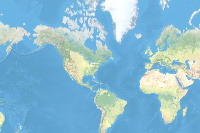

In [3]:
voter_zip = gis.content.get('650e7d6aa8fb4601a75d632a2c114425') 
voter_zip

In [4]:
import os, zipfile

In [5]:
filepath_new = voter_zip.download(file_name=voter_zip.name)
with zipfile.ZipFile(filepath_new, 'r') as zip_ref:
    zip_ref.extractall(Path(filepath_new).parent)
output_path = Path(os.path.join(os.path.splitext(filepath_new)[0]))
output_path = os.path.join(output_path,"VotersTurnoutCountyEelction2016.shp")  

In [6]:
output_path

'~\AppData\\Local\\Temp\\VotersTurnoutCountyEelction2016\\VotersTurnoutCountyEelction2016.shp'

The attribute table contains the voter turnout data by county for the entire US, which is extracted here as a pandas dataframe. The  `voter_turn` field in the dataframe contains the voter turnout data in percentages for each county for the 2016 election. This will be used as the dependent variable and will be predicted using the various demographic and socioeconomic variables for each county.

In [7]:
# getting the attribute table from the shapefile which will be used for building the model
sdf_main = pd.DataFrame.spatial.from_featureclass(output_path)
sdf_main.head()

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,NNeighbors,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE
0,0,1,1,01001,Autauga,Alabama,0.613738,38.6,25553,4.96,...,44,0.21158,0.154568,0,0,249674.500799,2208597808.5,133735.292502,0,"{""rings"": [[[-9619465, 3856529.0001000017], [-..."
1,1,1,2,01003,Baldwin,Alabama,0.627364,42.9,31429,4.64,...,22,0.358894,0.057952,0,0,1642763.26146,5671095677.35,241925.196426,3,"{""rings"": [[[-9746859, 3539643.0001000017], [-..."
2,2,1,3,01005,Barbour,Alabama,0.513816,40.2,16876,3.49,...,62,-0.868722,-0.498354,1,1,320297.06515,3257816458.5,0.0,0,"{""rings"": [[[-9468394, 3771591.0001000017], [-..."
3,3,1,4,01007,Bibb,Alabama,0.501364,39.3,19360,3.64,...,43,-1.003341,0.28644,0,0,227910.108916,2311954706.0,170214.485759,7,"{""rings"": [[[-9692114, 3928124.0001000017], [-..."
4,4,1,5,01009,Blount,Alabama,0.603064,40.9,21785,3.86,...,51,0.096177,-0.336198,0,1,291875.255483,2456919058.5,21128.568784,7,"{""rings"": [[[-9623907, 4063676.0001000017], [-..."


In [8]:
sdf_main.shape

(3112, 97)

The data is visualized here by mapping the voter turnout field into five classes. It can be seen that there is a belt running along the southeastern part of the country, which represents comparatively lower voter turnout of less than 55%.

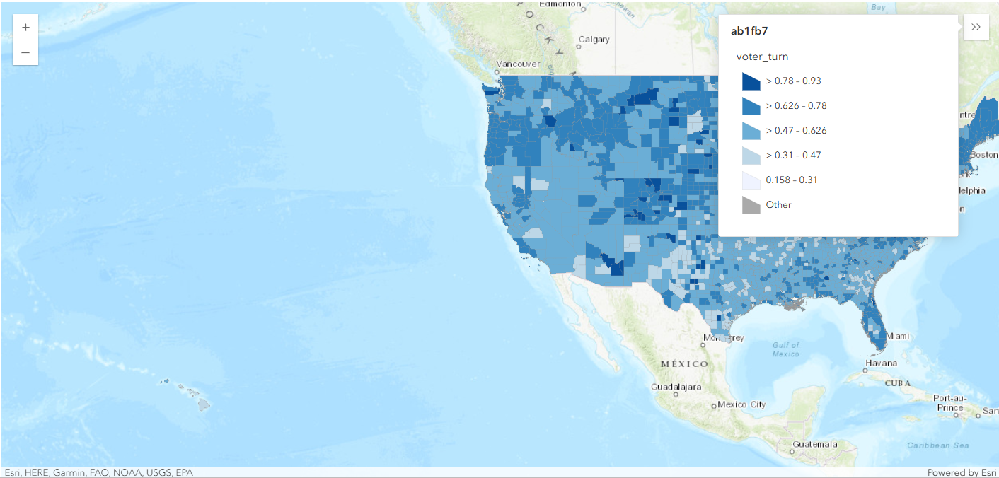

In [9]:
# # Visualizing voters turnout in percentages by county
m1 = GIS().map('United States')
m1.legend.enabled = True
m1

In [10]:
m1.content.add(sdf_main)

In [11]:
m1.zoom_to_layer(sdf_main)

Applying symbology on the feature layer

In [12]:
sm_manager = m1.content.renderer(0).smart_mapping()
sm_manager.class_breaks_renderer(field="voter_turn", break_type = "color", num_classes=5)

## Model Building <a class="anchor" id="9"></a>

Once the dataset is divided into the training and test dataset, the training data is ready to be used for modeling.

###  Train-Test Data split<a class="anchor" id="70"></a>

The dataset above has 3112 samples, each representing US counties and their voter turnout, along with related variables. Next, it will be split into training and test datasets, in a 90 to 10 ratio for training and validation respectively.

In [13]:
from sklearn.model_selection import train_test_split

In [14]:
# Splitting data with a test size of 10% for validation 
test_size = 0.10
sdf_train_base, sdf_test_base = train_test_split(sdf_main, test_size = test_size, random_state=42)

In [15]:
sdf_train_base.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,NNeighbors,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE
1798,1798,1,1799,36001,Albany,New York,0.587546,40.1,38227,5.0,...,31,-0.071597,-0.099099,0,0,225997.958853,2550719523.0,150330.823825,589,"{""rings"": [[[-8201660, 5279044.000100002], [-8..."
1003,1003,1,1004,21081,Grant,Kentucky,0.54174,36.9,20490,3.59,...,87,-0.566824,-0.125723,0,0,148480.244249,1108905122.5,84976.878589,339,"{""rings"": [[[-9419382, 4693378.000100002], [-9..."


In [16]:
# checking the columns in the dataset
sdf_main.columns

Index(['FID', 'Join_Count', 'TARGET_FID', 'FIPS', 'county', 'state',
       'voter_turn', 'gender_med', 'householdi', 'electronic', 'raceandhis',
       'voter_laws', 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1', 'randomized',
       

### Data Preparation <a class="anchor" id="11"></a>

First, a list of explanatory variables is chosen that consists of the feature data that will be used for predicting voter turnout. By default, it will receive continuous variables, and in the case of categorical variables, the **True** value is passed inside a tuple, along with the variable. Here `county`, `state` and `voter_laws` are categorical variables.

In [17]:
# listing explanatory variables
X =[('county',True), ('state',True),'gender_med', 'householdi', 'electronic', 'raceandhis',
       ('voter_laws',True), 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1',
        'City10Dist','City9Dist', 'City8Dist', 'City7Dist','City6Dist',
        'City5Dist']

The preprocessor uses a scaler to transform the explanatory variables, which is defined as follows:

In [18]:
from sklearn.preprocessing import MinMaxScaler

In [19]:
# defining the preprocessors for scaling data
preprocessors = [('county', 'state','gender_med', 'householdi', 'electronic', 'raceandhis',
       'voter_laws', 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1',
        'City10Dist', 'City9Dist',
       'City8Dist', 'City7Dist','City6Dist',
       'City5Dist', MinMaxScaler())]

Finally, using the explanatory variables list above, the preprocessors and the prediction variable of voter turnout, the prepare_tabulardata prepares the data to be fed into the model.

In [20]:
# preparing data for the model
data_base_model = prepare_tabulardata(sdf_train_base,
                           variable_predict='voter_turn',
                           explanatory_variables=X, 
                           preprocessors=preprocessors)

## Fitting a random forest model  <a class="anchor" id="5"></a> 

First a random forest model is fitted to the data, and its performance is measured.

### Model Initialization <a class="anchor" id="12"></a>

The MLModel is initialized with the Random Forest model from Sklearn, along with its model parameters.

In [21]:
# defining the model along with the parameters 
model = MLModel(data_base_model, 'sklearn.ensemble.RandomForestRegressor', n_estimators=500, random_state=43)

In [22]:
model.fit()

In [23]:
model.score()

0.6400988935906538

In [24]:
# validating trained model on test dataset
voter_county_mlmodel_predicted = model.predict(sdf_test_base, prediction_type='dataframe')

In [25]:
voter_county_mlmodel_predicted.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE,prediction_results
557,557,1,558,16073,Owyhee,Idaho,0.529332,37.1,19701,3.66,...,-0.700966,-0.496409,0,0,942771.682539,36793231250.5,484820.245797,672,"{""rings"": [[[-12970046, 5356298.000100002], [-...",0.531904
416,416,1,417,13119,Franklin,Georgia,0.506977,42.2,18965,3.44,...,-0.942663,-0.089913,0,0,152970.676619,1015526410.0,129997.253626,591,"{""rings"": [[[-9245266, 4095289.0001000017], [-...",0.534624


In [26]:
import sklearn.metrics as metrics

In [27]:
# calculating validation model score
r_square_voter_county_mlmodel_Test = metrics.r2_score(voter_county_mlmodel_predicted['voter_turn'], voter_county_mlmodel_predicted['prediction_results']) 
print('r_square_voter_county_mlmodel_Test: ', round(r_square_voter_county_mlmodel_Test,2))

r_square_voter_county_mlmodel_Test:  0.71


The validation r square for the random forest model is satisfactory, and now AutoML will be used to improve it.

## Fitting Using AutoML  <a class="anchor" id="6"></a> 

The same data obtained using the prepare_taular data function is next used as input for the AutoML model. Out of the various AutoML modes available, here the compete mode is used which uses 10-fold CV (Cross-Validation) and the Decision Tree, Random Forest, Extra Trees, XGBoost, Neural Network, Nearest Neighbors, Ensemble, and Stacking models to achieve higher machine learning accuracy.

In [28]:
# initializing AutoML model with the Compete mode 
AutoML_voters_county_base_compete = AutoML(data_base_model, eval_metric='r2', mode='Compete', n_jobs=1)

In the above initialization, the `Compete` mode is selected out of the three available modes, `Compete`, `Perform`, and `Compete`. While `Compete` is the best performing mode, it also consumes a significant amount of resources and time, and it is only recommended for instances where the best results are necessary. In other cases, the Explain or Perform modes can be used for a faster basic fit.

In [29]:
# training the AutoML model
AutoML_voters_county_base_compete.fit()

Neural Network algorithm was disabled because it doesn't support n_jobs parameter.
AutoML directory: ~\AppData\Local\Temp\scratch\tmp065_13k2
The task is regression with evaluation metric r2
AutoML will use algorithms: ['Linear', 'Decision Tree', 'Random Trees', 'Extra Trees', 'LightGBM', 'Xgboost']
AutoML will stack models
AutoML will ensemble available models
AutoML steps: ['adjust_validation', 'simple_algorithms', 'default_algorithms', 'not_so_random', 'mix_encoding', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'boost_on_errors', 'ensemble', 'stack', 'ensemble_stacked']
* Step adjust_validation will try to check up to 1 model
1_DecisionTree r2 0.339807 trained in 6.53 seconds
Adjust validation. Remove: 1_DecisionTree
Validation strategy: 5-fold CV Shuffle
* Step simple_algorithms will try to check up to 4 models
1_DecisionTree r2 0.384567 trained in 11.87 seconds
2_DecisionTree r2 0.438367 trained in 10.57 seconds
3_DecisionTree r2 0.440063 t

6_Default_Xgboost r2 0.765353 trained in 45.17 seconds
7_Default_RandomTrees r2 0.582249 trained in 94.64 seconds
8_Default_ExtraTrees r2 0.525917 trained in 34.52 seconds
* Step not_so_random will try to check up to 36 models
18_LightGBM r2 0.778586 trained in 19.69 seconds


9_Xgboost r2 0.74601 trained in 60.14 seconds
27_RandomTrees r2 0.584312 trained in 76.86 seconds
36_ExtraTrees r2 0.509314 trained in 34.63 seconds
19_LightGBM r2 0.745846 trained in 17.38 seconds


10_Xgboost r2 0.741448 trained in 69.99 seconds
28_RandomTrees r2 0.518539 trained in 61.65 seconds
37_ExtraTrees r2 0.461816 trained in 27.51 seconds
20_LightGBM r2 0.772607 trained in 34.54 seconds


11_Xgboost r2 0.773569 trained in 21.86 seconds
29_RandomTrees r2 0.654122 trained in 161.82 seconds
38_ExtraTrees r2 0.611619 trained in 37.09 seconds
21_LightGBM r2 0.758954 trained in 62.74 seconds


12_Xgboost r2 0.752604 trained in 20.04 seconds
30_RandomTrees r2 0.648906 trained in 110.54 seconds
39_ExtraTrees r2 0.592089 trained in 29.68 seconds
22_LightGBM r2 0.754357 trained in 17.2 seconds


13_Xgboost r2 0.775421 trained in 23.6 seconds
31_RandomTrees r2 0.675828 trained in 118.82 seconds
40_ExtraTrees r2 0.623064 trained in 38.19 seconds
23_LightGBM r2 0.774772 trained in 25.83 seconds


14_Xgboost r2 0.771997 trained in 24.1 seconds
32_RandomTrees r2 0.668177 trained in 199.31 seconds
41_ExtraTrees r2 0.634077 trained in 29.54 seconds
24_LightGBM r2 0.776354 trained in 35.68 seconds


15_Xgboost r2 0.773189 trained in 43.42 seconds
33_RandomTrees r2 0.58038 trained in 116.53 seconds
42_ExtraTrees r2 0.52028 trained in 33.13 seconds
25_LightGBM r2 0.768833 trained in 20.25 seconds
* Step mix_encoding will try to check up to 1 model


13_Xgboost_categorical_mix r2 0.775825 trained in 22.61 seconds
* Step insert_random_feature will try to check up to 1 model
18_LightGBM_RandomFeature r2 0.774383 trained in 134.49 seconds
Drop features ['disposab_7', 'random_feature', 'hispanic_1', 'educatio_2', 'disposab_4', 'disposa_10', 'F5yearin_2', 'househol_2', 'disposab_9', 'disposab_1', 'househol_4', 'disposab_6', 'miscellane', 'county_brown', 'county_pulaski', 'county_carbon', 'county_rock', 'county_grundy', 'county_la', 'county_miami', 'county_river', 'county_butte', 'county_richland', 'county_anderson', 'county_pierce', 'county_kent', 'county_henderson', 'county_richmond', 'county_randolph', 'county_caldwell', 'county_green', 'county_garfield', 'county_allen', 'county_sheridan', 'county_sherman', 'county_sullivan', 'county_valley', 'county_wilson', 'county_middlesex', 'county_mitchell', 'county_phillips', 'county_lancaster', 'county_george', 'county_park', 'county_red', 'county_dallas', 'county_charles', 'county_clair', 'co

13_Xgboost_categorical_mix_SelectedFeatures r2 0.774165 trained in 19.28 seconds
31_RandomTrees_SelectedFeatures r2 0.678155 trained in 93.54 seconds
41_ExtraTrees_SelectedFeatures r2 0.637948 trained in 21.32 seconds
* Step hill_climbing_1 will try to check up to 24 models
43_LightGBM_SelectedFeatures r2 0.783672 trained in 18.01 seconds
44_LightGBM r2 0.772547 trained in 18.42 seconds
45_LightGBM r2 0.769483 trained in 26.0 seconds


46_Xgboost r2 0.770869 trained in 23.87 seconds


47_Xgboost r2 0.774883 trained in 23.82 seconds


48_Xgboost r2 0.775008 trained in 26.4 seconds


49_Xgboost r2 0.776888 trained in 24.93 seconds


50_Xgboost_SelectedFeatures r2 0.776082 trained in 20.86 seconds


51_Xgboost_SelectedFeatures r2 0.775982 trained in 21.4 seconds
52_RandomTrees_SelectedFeatures r2 0.686752 trained in 94.93 seconds
53_RandomTrees_SelectedFeatures r2 0.674463 trained in 98.79 seconds
* Step hill_climbing_2 will try to check up to 22 models
54_LightGBM_SelectedFeatures r2 0.781741 trained in 18.24 seconds
55_LightGBM_SelectedFeatures r2 0.785634 trained in 23.24 seconds
56_LightGBM r2 0.782188 trained in 25.46 seconds


57_Xgboost r2 0.772739 trained in 26.52 seconds


58_Xgboost r2 0.77337 trained in 28.45 seconds


59_Xgboost_SelectedFeatures r2 0.777363 trained in 21.46 seconds


60_Xgboost_SelectedFeatures r2 0.780775 trained in 21.44 seconds


61_Xgboost_SelectedFeatures r2 0.770041 trained in 19.53 seconds


62_Xgboost_SelectedFeatures r2 0.776709 trained in 21.37 seconds
63_RandomTrees_SelectedFeatures r2 0.685755 trained in 88.82 seconds
* Step boost_on_errors will try to check up to 1 model
55_LightGBM_SelectedFeatures_BoostOnErrors r2 0.782378 trained in 22.47 seconds
* Step ensemble will try to check up to 1 model
Ensemble r2 0.792575 trained in 10.53 seconds
* Step stack will try to check up to 38 models
55_LightGBM_SelectedFeatures_Stacked r2 0.776583 trained in 16.33 seconds


60_Xgboost_SelectedFeatures_Stacked r2 0.764339 trained in 17.01 seconds
52_RandomTrees_SelectedFeatures_Stacked r2 0.784741 trained in 243.34 seconds
41_ExtraTrees_SelectedFeatures_Stacked r2 0.787197 trained in 32.22 seconds
43_LightGBM_SelectedFeatures_Stacked r2 0.776042 trained in 15.71 seconds


59_Xgboost_SelectedFeatures_Stacked r2 0.766169 trained in 16.9 seconds
63_RandomTrees_SelectedFeatures_Stacked r2 0.78466 trained in 263.52 seconds
41_ExtraTrees_Stacked not trained. Stop training after the first fold. Time needed to train on the first fold 8.0 seconds. The time estimate for training on all folds is larger than total_time_limit.
56_LightGBM_Stacked r2 0.775774 trained in 18.89 seconds


49_Xgboost_Stacked not trained. Stop training after the first fold. Time needed to train on the first fold 2.0 seconds. The time estimate for training on all folds is larger than total_time_limit.
31_RandomTrees_SelectedFeatures_Stacked not trained. Stop training after the first fold. Time needed to train on the first fold 46.0 seconds. The time estimate for training on all folds is larger than total_time_limit.
* Step ensemble_stacked will try to check up to 1 model
Ensemble_Stacked r2 0.792647 trained in 13.55 seconds
AutoML fit time: 3662.3 seconds
AutoML best model: Ensemble_Stacked
All the evaluated models are saved in the path  ~\AppData\Local\Temp\scratch\tmp065_13k2


AutoML significantly improves the fit when compared to the standalone random forest model, and the validation r square jumps to a new high. Now, the previous visualization of the data reveals the presence of a spatial pattern in the data, and in the second part of the notebook, this spatial pattern is estimated and included as a spatial feature to further improve the model.

In [30]:
# train score of the model
AutoML_voters_county_base_compete.score()

0.9602925513426736

### Model output  <a class="anchor" id="5f"></a>

In [31]:
# The output diagnostics can also be printed in a report form
AutoML_voters_county_base_compete.report()

In case the report html is not rendered appropriately in the notebook, the same can be found in the path ~\AppData\Local\Temp\scratch\tmp065_13k2\README.html


Best model,name,model_type,metric_type,metric_value,train_time
,1_DecisionTree,Decision Tree,r2,0.384567,12.38
,2_DecisionTree,Decision Tree,r2,0.438367,11.18
,3_DecisionTree,Decision Tree,r2,0.440063,11.12
,4_Linear,Linear,r2,0.651521,13.03
,5_Default_LightGBM,LightGBM,r2,0.773111,48.66
,6_Default_Xgboost,Xgboost,r2,0.765353,45.81
,7_Default_RandomTrees,Random Trees,r2,0.582249,95.19
,8_Default_ExtraTrees,Extra Trees,r2,0.525917,35.09
,18_LightGBM,LightGBM,r2,0.778586,20.18
,9_Xgboost,Xgboost,r2,0.74601,60.83


## Voters turnout prediction & Validation <a class="anchor" id="8a"></a>

In [32]:
# validating trained model on test dataset
voter_county_automl_predicted = AutoML_voters_county_base_compete.predict(sdf_test_base, prediction_type='dataframe')

In [33]:
voter_county_automl_predicted.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE,prediction_results
557,557,1,558,16073,Owyhee,Idaho,0.529332,37.1,19701,3.66,...,-0.700966,-0.496409,0,0,942771.682539,36793231250.5,484820.245797,672,"{""rings"": [[[-12970046, 5356298.000100002], [-...",0.524788
416,416,1,417,13119,Franklin,Georgia,0.506977,42.2,18965,3.44,...,-0.942663,-0.089913,0,0,152970.676619,1015526410.0,129997.253626,591,"{""rings"": [[[-9245266, 4095289.0001000017], [-...",0.520055


### Estimate model metrics for validation <a class="anchor" id="8c"></a>

In [34]:
import sklearn.metrics as metrics

In [35]:
r_square_voter_county_automl_Test = metrics.r2_score(voter_county_automl_predicted['voter_turn'], voter_county_automl_predicted['prediction_results']) 
print('r_square_voter_county_automl_Test: ', round(r_square_voter_county_automl_Test,2))

r_square_voter_county_automl_Test:  0.78


## Conclusion<a class="anchor" id="10"></a>

In this notebook, AutoML was applied to a regression dataset and was able to achieve significant improvement over traditional methods of modeling. Data visualization also showed the presence of spatial autocorrelation in voter turnout distributed across the country. The fit of the model can be further improved by extracting this spatial pattern in the data, and this process is elaborated on in part two of this notebook.

### Data resources <a class="anchor" id="25"></a>

| Reference | Source | Link |
| -| - |-|
|Voters turnout by county for 2016 US general election|Esri| https://www.arcgis.com/home/item.html?id=650e7d6aa8fb4601a75d632a2c114425|